In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
os.chdir(r'D:\Hackathon')
print(os.listdir())

['Hackathon_4.0_ML_Guidelines.pdf', 'Solution_Sheet.docx', 'Test_dataset.xlsx', 'Train_dataset.xlsx', 'Variable_Description.xlsx']


In [2]:
variables=pd.read_excel("Variable_Description.xlsx")
train=pd.read_excel("Train_dataset.xlsx")
test=pd.read_excel("Test_dataset.xlsx")

In [3]:
train.head()

,people_ID,Region,Gender,Designation,Name,Married,Children,Occupation,Mode_transport,cases/1M,...,HBB,d-dimer,Heart rate,HDL cholesterol,Charlson Index,Blood Glucose,Insurance,salary,FT/month,Infect_Prob
0,1,Bhubaneshwar,Female,Mrs,mansi,YES,1.0,Farmer,Public,2,...,93.0,233.0,82.0,58.0,27,7,3600000.0,1300000,2.0,49.135010
1,2,Bhubaneshwar,Female,Mrs,riya masi,YES,2.0,Farmer,Walk,2,...,56.0,328.0,89.0,68.0,5,6,1600000.0,400000,1.0,51.147880
2,3,Bhubaneshwar,Female,Mrs,sunita,NO,1.0,Cleaner,Public,2,...,137.0,213.0,77.0,43.0,40,6,3400000.0,900000,1.0,73.224000
3,4,Bhubaneshwar,Female,Mrs,anjali @ babli,YES,1.0,Driver,Car,2,...,167.0,275.0,64.0,60.0,27,7,700000.0,2300000,1.0,48.779225
4,5,Bhubaneshwar,Female,Mrs,champa karketta,NO,2.0,Manufacturing,Car,2,...,153.0,331.0,71.0,64.0,32,7,3200000.0,1100000,1.0,87.868800


In [4]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14498 entries, 0 to 14497
Data columns (total 27 columns):
people_ID                 14498 non-null int64
Region                    14498 non-null object
Gender                    14498 non-null object
Designation               14498 non-null object
Name                      14466 non-null object
Married                   14498 non-null object
Children                  14498 non-null int64
Occupation                14498 non-null object
Mode_transport            14498 non-null object
cases/1M                  14498 non-null int64
Deaths/1M                 14498 non-null int64
comorbidity               14498 non-null object
Age                       14498 non-null int64
Coma score                14498 non-null int64
Pulmonary score           14498 non-null object
cardiological pressure    14498 non-null object
Diuresis                  14498 non-null int64
Platelets                 14498 non-null int64
HBB                       14498 non

In [5]:
train.describe()

,people_ID,Children,cases/1M,Deaths/1M,Age,Coma score,Diuresis,Platelets,HBB,d-dimer,Heart rate,HDL cholesterol,Charlson Index,Blood Glucose,Insurance,salary,FT/month,Infect_Prob
count,10714.000000,10403.000000,10714.000000,10714.000000,10714.000000,10714.000000,9998.000000,9790.000000,10698.000000,9600.000000,9600.000000,10679.000000,10714.000000,10714.000000,9.624000e+03,1.071400e+04,9991.000000,10714.000000
mean,10084.893784,1.062770,3.285888,0.523241,42.083722,9.013067,278.806261,87.795812,116.170967,275.292292,74.847396,52.632737,20.028094,5.015027,2.644919e+06,1.304713e+06,1.004604,52.280680
std,7108.663645,0.818222,2.721274,0.854303,15.323397,3.714970,97.985526,41.851103,55.178811,43.669692,14.869104,10.434293,11.828445,1.399770,1.383346e+06,6.075947e+05,0.815257,10.674667
min,1.000000,0.000000,1.000000,0.000000,16.000000,3.000000,110.000000,15.000000,20.000000,200.000000,50.000000,35.000000,0.000000,3.000000,3.000000e+05,3.000000e+05,0.000000,29.289600
25%,2679.250000,0.000000,2.000000,0.000000,29.000000,6.000000,194.000000,52.000000,68.000000,237.000000,62.000000,44.000000,10.000000,4.000000,1.400000e+06,8.000000e+05,0.000000,47.277426
50%,10003.500000,1.000000,2.000000,0.000000,42.000000,9.000000,276.000000,88.000000,117.000000,276.000000,75.000000,53.000000,20.000000,5.000000,2.600000e+06,1.300000e+06,1.000000,49.008389
75%,15141.750000,2.000000,4.000000,1.000000,55.000000,12.000000,364.000000,124.000000,165.000000,313.000000,88.000000,62.000000,30.000000,6.000000,3.800000e+06,1.800000e+06,2.000000,52.762313
max,22695.000000,2.000000,8.000000,2.000000,68.000000,15.000000,450.000000,160.000000,210.000000,350.000000,100.000000,70.000000,40.000000,7.000000,5.000000e+06,2.300000e+06,2.000000,97.632000


In [6]:
print("Unique DataSet In Train :"+str(len(train['people_ID'].unique())))
print("Unique DataSet In Test :"+str(len(test['people_ID'].unique())))

Unique DataSet In Train :10714
Unique DataSet In Test :14498


In [7]:
# Dropping Irrelevant Features
train.drop(['people_ID','Name'],axis=1,inplace=True)
test.drop(['people_ID','Name'],axis=1,inplace=True)

In [8]:
train.head()

,Region,Gender,Designation,Married,Children,Occupation,Mode_transport,cases/1M,Deaths/1M,comorbidity,...,HBB,d-dimer,Heart rate,HDL cholesterol,Charlson Index,Blood Glucose,Insurance,salary,FT/month,Infect_Prob
0,Bhubaneshwar,Female,Mrs,YES,1.0,Farmer,Public,2,0,Hypertension,...,93.0,233.0,82.0,58.0,27,7,3600000.0,1300000,2.0,49.135010
1,Bhubaneshwar,Female,Mrs,YES,2.0,Farmer,Walk,2,0,Diabetes,...,56.0,328.0,89.0,68.0,5,6,1600000.0,400000,1.0,51.147880
2,Bhubaneshwar,Female,Mrs,NO,1.0,Cleaner,Public,2,0,None,...,137.0,213.0,77.0,43.0,40,6,3400000.0,900000,1.0,73.224000
3,Bhubaneshwar,Female,Mrs,YES,1.0,Driver,Car,2,0,Coronary Heart Disease,...,167.0,275.0,64.0,60.0,27,7,700000.0,2300000,1.0,48.779225
4,Bhubaneshwar,Female,Mrs,NO,2.0,Manufacturing,Car,2,0,Diabetes,...,153.0,331.0,71.0,64.0,32,7,3200000.0,1100000,1.0,87.868800


Null Values in Region Feature in Train: 0
Null Values in Region Feature in Test: 0


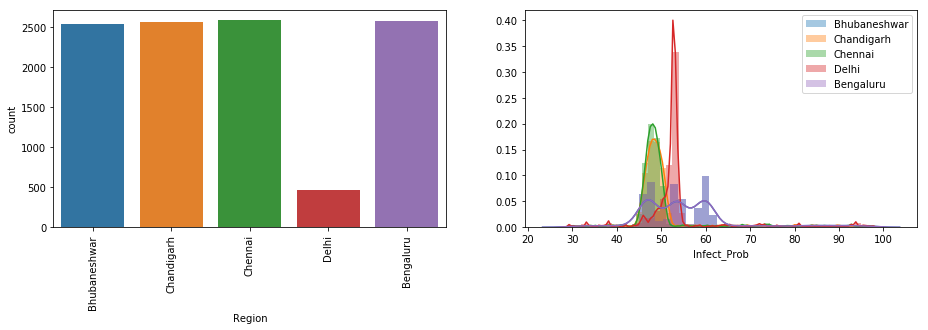

In [9]:
plt.subplots_adjust(left=10,right=12)
plt.subplot(1,2,1)
sns.countplot(train.Region)
plt.xticks(rotation=90)

plt.subplot(1,2,2)
dfb=train[train.Region=='Bhubaneshwar']
dfc=train[train.Region=='Chandigarh']
dfch=train[train.Region=='Chennai']
dfd=train[train.Region=='Delhi']
dfb=train[train.Region=='Bengaluru']
sns.distplot(dfb.Infect_Prob)
sns.distplot(dfc.Infect_Prob)
sns.distplot(dfch.Infect_Prob)
sns.distplot(dfd.Infect_Prob)
sns.distplot(dfb.Infect_Prob)
plt.legend(['Bhubaneshwar','Chandigarh','Chennai','Delhi','Bengaluru'])
print("Null Values in Region Feature in Train: "+str(train.Region.isnull().sum()))
print("Null Values in Region Feature in Test: "+str(test.Region.isnull().sum()))

# Conclusion:
# There is a large peak in 55% Infected Prob for Delhi Region and approx 50% for Chennai

Null Values in Gender Feature in Train: 0
Null Values in Gender Feature in Test: 0


Female    5423
Male      5291
Name: Gender, dtype: int64

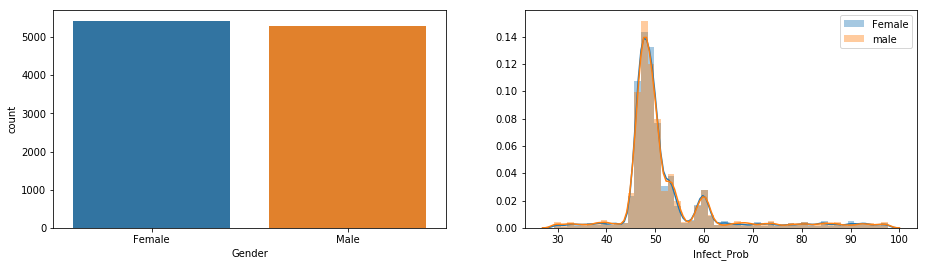

In [10]:
plt.subplots_adjust(left=10,right=12)
plt.subplot(1,2,1)
sns.countplot(train.Gender)
plt.subplot(1,2,2)
dff=train[train.Gender=='Female']
dfm=train[train.Gender=='Male']
sns.distplot(dff.Infect_Prob)
sns.distplot(dfm.Infect_Prob)
plt.legend(['Female','male'])
print("Null Values in Gender Feature in Train: "+str(train.Gender.isnull().sum()))
print("Null Values in Gender Feature in Test: "+str(test.Gender.isnull().sum()))
train['Gender'].value_counts()


# Conclusion:
# Infected Probability Distribution is Similar for both the Genders

Null Values in Designation Feature in Train: 0
Null Values in Designation Feature in Test: 0


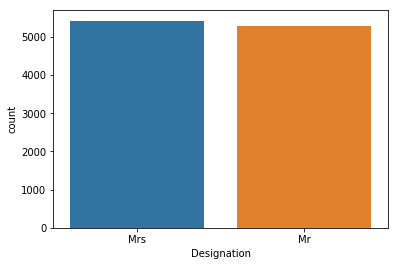

In [11]:
sns.countplot(train.Designation)
print("Null Values in Designation Feature in Train: "+str(train.Designation.isnull().sum()))
print("Null Values in Designation Feature in Test: "+str(test.Designation.isnull().sum()))
train['Designation'].value_counts()
# Since no. of MRS are same as female so lets drop Designation Feature
train.drop(['Designation'],axis=1,inplace=True)
test.drop(['Designation'],axis=1,inplace=True)

Null Values in Childer in Train: 311
Null Values in Childern Feature in Test: 0


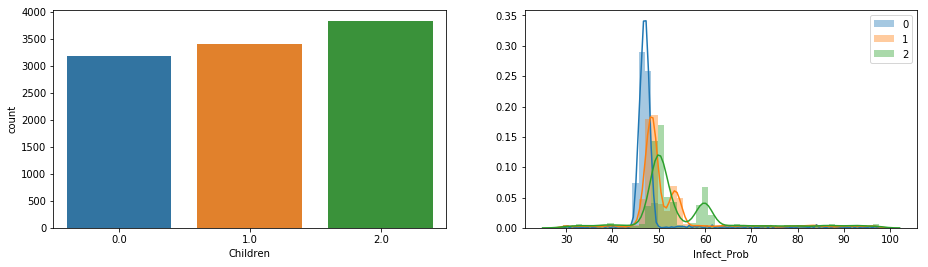

In [12]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train.Children)
print("Null Values in Childer in Train: "+str(train.Children.isnull().sum()))
print("Null Values in Childern Feature in Test: "+str(test.Children.isnull().sum()))
#Lets fill the Children with the Mode of Children
train.Children=train['Children'].fillna(2.0)
plt.subplot(1,2,2)
df0=train[train.Children==0.0]
df1=train[train.Children==1.0]
df2=train[train.Children==2.0]
sns.distplot(df0.Infect_Prob)
sns.distplot(df1.Infect_Prob)
sns.distplot(df2.Infect_Prob)
plt.legend(['0','1','2'])

# Conclusion:
#There is a peak at 60% for those who have 2 children 

Null Values in occupation Feature in Train: 747
Null Values in occupation Feature in Test: 0
Legal            1174
Sales            1131
Manufacturing    1120
Researcher       1115
Farmer           1113
Cleaner          1111
Clerk            1078
Driver           1072
Business         1053
Name: Occupation, dtype: int64


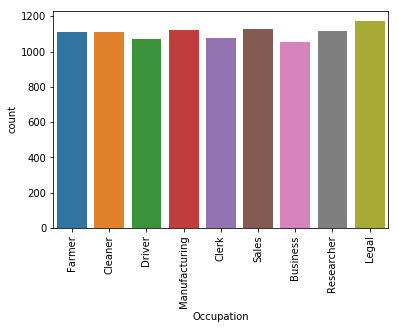

In [13]:
sns.countplot(train.Occupation)
plt.xticks(rotation=90)
print("Null Values in occupation Feature in Train: "+str(train.Occupation.isnull().sum()))
print("Null Values in occupation Feature in Test: "+str(test.Occupation.isnull().sum()))
print(train.Occupation.value_counts())
# Lets fill the null values with the most common occupation which is Legal
train.Occupation=train['Occupation'].fillna("Legal")

Null Values in Mode_transport Feature in Train: 3
Null Values in Mode_transport Feature in Test: 0


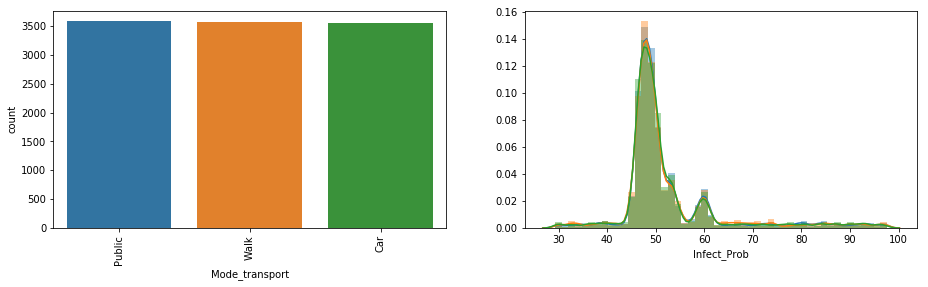

In [14]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train.Mode_transport)
plt.xticks(rotation=90)

plt.subplot(1,2,2)
dfp=train[train.Mode_transport=='Public']
dfw=train[train.Mode_transport=='Walk']
dfc=train[train.Mode_transport=='Car']
sns.distplot(dfp.Infect_Prob)
sns.distplot(dfw.Infect_Prob)
sns.distplot(dfc.Infect_Prob)
print("Null Values in Mode_transport Feature in Train: "+str(train.Mode_transport.isnull().sum()))
print("Null Values in Mode_transport Feature in Test: "+str(test.Mode_transport.isnull().sum()))

train.Mode_transport.value_counts()
# Lets replace the null values by Public(Most common)

train.Mode_transport=train['Mode_transport'].fillna("Public")


Null Values in Married Feature in Train: 0
Null Values in Married Feature in Test: 0


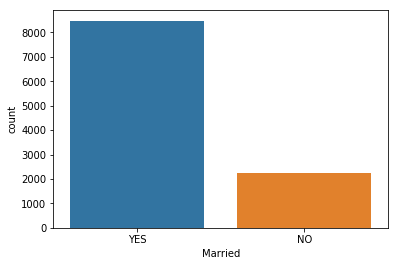

In [15]:
sns.countplot(train.Married)

print("Null Values in Married Feature in Train: "+str(train.Married.isnull().sum()))
print("Null Values in Married Feature in Test: "+str(test.Married.isnull().sum()))

Null Values in cases/1M  Feature in Train: 0
Null Values in cases/1M  Feature in Test: 0


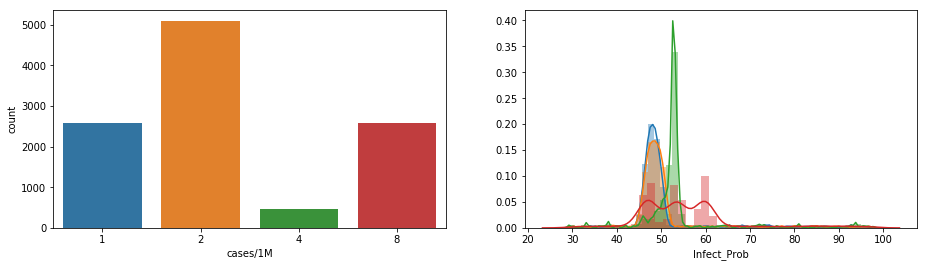

In [16]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train['cases/1M'])

plt.subplot(1,2,2)
df1=train[train['cases/1M']==1]
df2=train[train['cases/1M']==2]
df4=train[train['cases/1M']==4]
df8=train[train['cases/1M']==8]
sns.distplot(df1.Infect_Prob)
sns.distplot(df2.Infect_Prob)
sns.distplot(df4.Infect_Prob)
sns.distplot(df8.Infect_Prob)
print("Null Values in cases/1M  Feature in Train: "+str(train['cases/1M'].isnull().sum()))
print("Null Values in cases/1M  Feature in Test: "+str(test['cases/1M'].isnull().sum()))

Null Values in Deaths/1M  Feature in Train: 0
Null Values in Deaths/1M  Feature in Test: 0


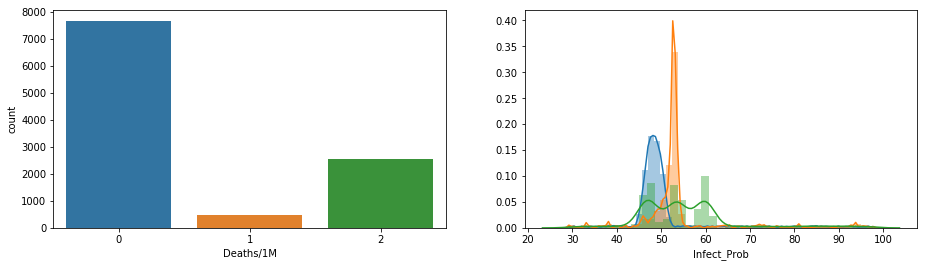

In [17]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train['Deaths/1M'])

plt.subplot(1,2,2)
df0=train[train['Deaths/1M']==0]
df1=train[train['Deaths/1M']==1]
df2=train[train['Deaths/1M']==2]

sns.distplot(df0.Infect_Prob)
sns.distplot(df1.Infect_Prob)
sns.distplot(df2.Infect_Prob)

print("Null Values in Deaths/1M  Feature in Train: "+str(train['Deaths/1M'].isnull().sum()))
print("Null Values in Deaths/1M  Feature in Test: "+str(test['Deaths/1M'].isnull().sum()))


Null Values in comorbidity  Feature in Train: 226
Null Values in comorbidity  Feature in Test: 0


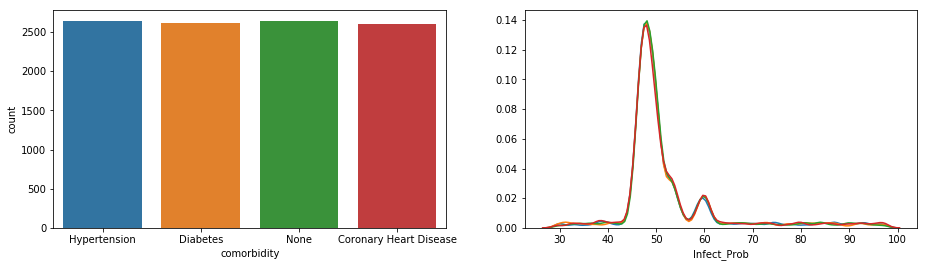

In [18]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train['comorbidity'])

plt.subplot(1,2,2)
dfh=train[train.comorbidity=='Hypertension']
dfd=train[train.comorbidity=='Diabetes']
dfn=train[train.comorbidity=='None']
dfC=train[train.comorbidity=='Coronary Heart Disease']

sns.distplot(dfh.Infect_Prob,hist=False)
sns.distplot(dfd.Infect_Prob,hist=False)
sns.distplot(dfn.Infect_Prob,hist=False)
sns.distplot(dfC.Infect_Prob,hist=False)

print("Null Values in comorbidity  Feature in Train: "+str(train['comorbidity'].isnull().sum()))
print("Null Values in comorbidity  Feature in Test: "+str(test['comorbidity'].isnull().sum()))

train['comorbidity'].value_counts()

# Let's replace the null value with the most common i.e Hypertension

train.comorbidity=train['comorbidity'].fillna("Hypertension")


Null Values in Age Feature in Train: 0
Null Values in Age Feature in Test: 0


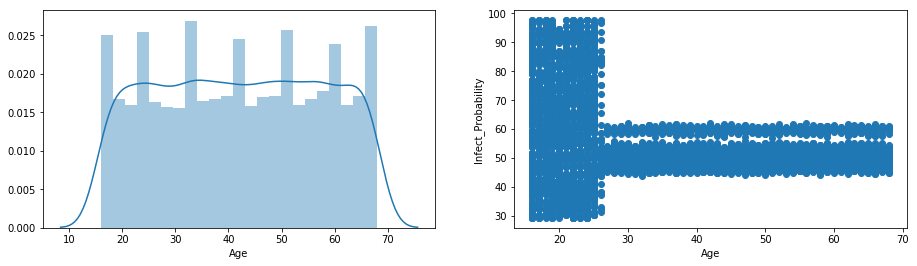

In [19]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train.Age)
plt.subplot(1,2,2)

plt.scatter(train.Age,train.Infect_Prob)
plt.xlabel("Age")
plt.ylabel("Infect_Probability")
print("Null Values in Age Feature in Train: "+str(train['Age'].isnull().sum()))
print("Null Values in Age Feature in Test: "+str(test['Age'].isnull().sum()))

Null Values in Coma score Feature in Train: 0
Null Values in Coma score Feature in Test: 0


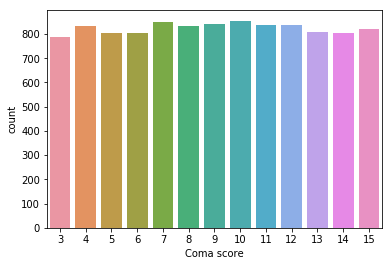

In [20]:
sns.countplot(train['Coma score'])
print("Null Values in Coma score Feature in Train: "+str(train['Coma score'].isnull().sum()))
print("Null Values in Coma score Feature in Test: "+str(test['Coma score'].isnull().sum()))

Null Values in Pulmonary score Feature in Train: 0
Null Values in Pulmonary score Feature in Test: 0


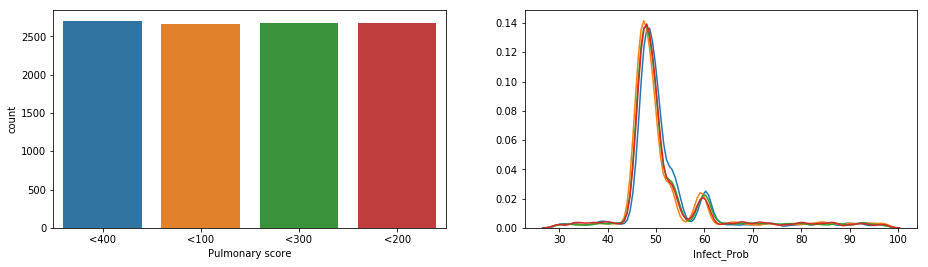

In [21]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train['Pulmonary score'])
plt.subplot(1,2,2)
df1=train[train['Pulmonary score']=='<100']
df2=train[train['Pulmonary score']=='<200']
df3=train[train['Pulmonary score']=='<300']
df4=train[train['Pulmonary score']=='<400']
sns.distplot(df1.Infect_Prob,hist=False)
sns.distplot(df2.Infect_Prob,hist=False)
sns.distplot(df3.Infect_Prob,hist=False)
sns.distplot(df4.Infect_Prob,hist=False)

print("Null Values in Pulmonary score Feature in Train: "+str(train['Pulmonary score'].isnull().sum()))
print("Null Values in Pulmonary score Feature in Test: "+str(test['Pulmonary score'].isnull().sum()))

Null Values in cardiological pressure Feature in Train: 97
Null Values in cardiological pressure Feature in Test: 0
Normal      2681
Stage-01    2657
Elevated    2641
Stage-02    2638
Name: cardiological pressure, dtype: int64


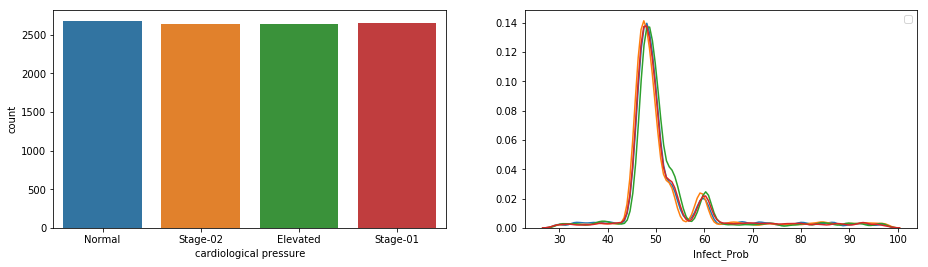

In [22]:
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train['cardiological pressure'])
plt.subplot(1,2,2)

dfn=train[train['cardiological pressure']=='Normal']
dfst01=train[train['cardiological pressure']=='Stage-01']
dfst02=train[train['cardiological pressure']=='Stage-02']
dfe=train[train['cardiological pressure']=='Elevated']

sns.distplot(dfn.Infect_Prob,hist=False)
sns.distplot(dfst01.Infect_Prob,hist=False)
sns.distplot(dfst02.Infect_Prob,hist=False)
sns.distplot(dfe.Infect_Prob,hist=False)
plt.legend(['Normal','Stage-01','Stage-02','Elevated'])
print("Null Values in cardiological pressure Feature in Train: "+str(train['cardiological pressure'].isnull().sum()))
print("Null Values in cardiological pressure Feature in Test: "+str(test['cardiological pressure'].isnull().sum()))

print(train['cardiological pressure'].value_counts())
# Most common value is Normal
train['cardiological pressure']=train['cardiological pressure'].fillna("Normal")

#Conclusion:
#distribution of the Infected Prob is same for all the Cardiological Pressure

Null Values in Diuresis Feature in Train: 716
Null Values in Diuresis Feature in Test: 0
count    9998.000000
mean      278.806261
std        97.985526
min       110.000000
25%       194.000000
50%       276.000000
75%       364.000000
max       450.000000
Name: Diuresis, dtype: float64


Text(0,0.5,'Infect_Probability')

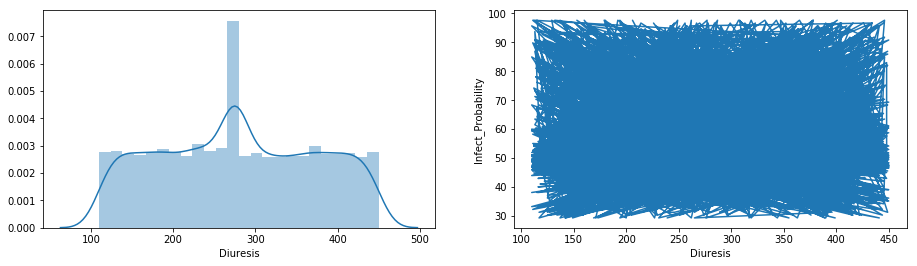

In [23]:

print("Null Values in Diuresis Feature in Train: "+str(train['Diuresis'].isnull().sum()))
print("Null Values in Diuresis Feature in Test: "+str(test['Diuresis'].isnull().sum()))
print(train['Diuresis'].describe())
# Replace the missing value with Median or Mean since they both are same and It also means there are npo outliers present
train['Diuresis']=train['Diuresis'].fillna(276.0)

plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['Diuresis'])
plt.subplot(1,2,2)
plt.plot(train['Diuresis'],train['Infect_Prob'])
plt.xlabel("Diuresis")
plt.ylabel("Infect_Probability")



Null Values in platlets Feature in Train: 924
Null Values in Platelets Feature in Test: 0
count    9790.000000
mean       87.795812
std        41.851103
min        15.000000
25%        52.000000
50%        88.000000
75%       124.000000
max       160.000000
Name: Platelets, dtype: float64


Text(0,0.5,'Infect_Probability')

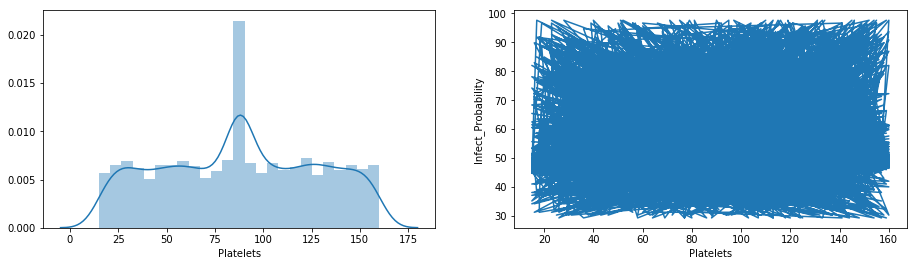

In [24]:
print("Null Values in platlets Feature in Train: "+str(train['Platelets'].isnull().sum()))
print("Null Values in Platelets Feature in Test: "+str(test['Platelets'].isnull().sum()))
print(train['Platelets'].describe())

# Replace the Nan values with Mean or median since they both are same and there are no outliers
train['Platelets']=train['Platelets'].fillna(88.00)
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['Platelets'])
plt.subplot(1,2,2)
plt.plot(train['Platelets'],train['Infect_Prob'])
plt.xlabel("Platelets")
plt.ylabel("Infect_Probability")



Null Values in platlets Feature in Train: 16
Null Values in HBB Feature in Test: 0
count    10698.000000
mean       116.170967
std         55.178811
min         20.000000
25%         68.000000
50%        117.000000
75%        165.000000
max        210.000000
Name: HBB, dtype: float64


Text(0,0.5,'Infect_Probability')

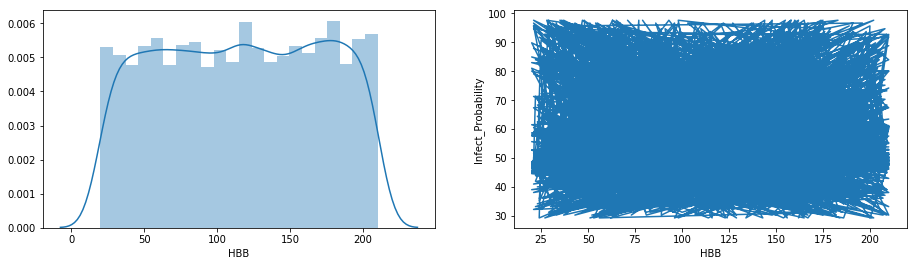

In [25]:
print("Null Values in platlets Feature in Train: "+str(train['HBB'].isnull().sum()))
print("Null Values in HBB Feature in Test: "+str(test['HBB'].isnull().sum()))
print(train['HBB'].describe())

# Replace the Nan values with Mean or median since they both are same and there are no outliers
train['HBB']=train['HBB'].fillna(117.00)
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['HBB'])
plt.subplot(1,2,2)
plt.plot(train['HBB'],train['Infect_Prob'])
plt.xlabel("HBB")
plt.ylabel("Infect_Probability")



Null Values in platlets Feature in Train: 1114
Null Values in d-dimer Feature in Test: 0
count    9600.000000
mean      275.292292
std        43.669692
min       200.000000
25%       237.000000
50%       276.000000
75%       313.000000
max       350.000000
Name: d-dimer, dtype: float64


Text(0,0.5,'Infect_Probability')

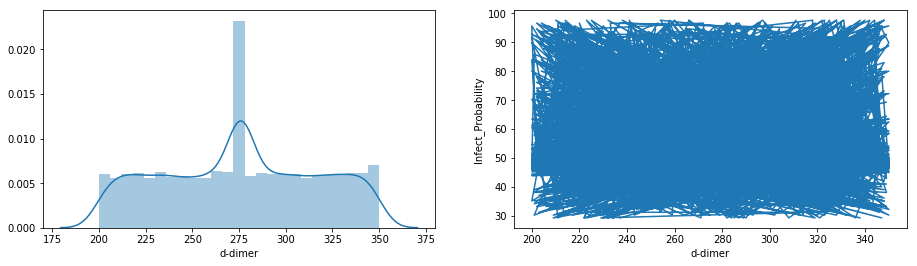

In [26]:

print("Null Values in platlets Feature in Train: "+str(train['d-dimer'].isnull().sum()))
print("Null Values in d-dimer Feature in Test: "+str(test['d-dimer'].isnull().sum()))
print(train['d-dimer'].describe())

# Replace the Nan values with Mean or median since they both are same and there are no outliers
train['d-dimer']=train['d-dimer'].fillna(276.00)
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['d-dimer'])
plt.subplot(1,2,2)
plt.plot(train['d-dimer'],train['Infect_Prob'])
plt.xlabel("d-dimer")
plt.ylabel("Infect_Probability")



Null Values in Heart rate Feature in Train: 1114
Null Values in Heart rate Feature in Test: 0
count    9600.000000
mean       74.847396
std        14.869104
min        50.000000
25%        62.000000
50%        75.000000
75%        88.000000
max       100.000000
Name: Heart rate, dtype: float64


Text(0,0.5,'Infect_Probability')

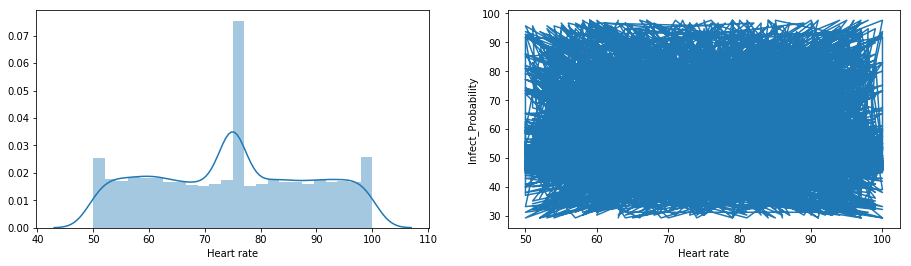

In [27]:

print("Null Values in Heart rate Feature in Train: "+str(train['Heart rate'].isnull().sum()))
print("Null Values in Heart rate Feature in Test: "+str(test['Heart rate'].isnull().sum()))
print(train['Heart rate'].describe())

# Replace the Nan values with Mean or median since they both are same and there are no outliers
train['Heart rate']=train['Heart rate'].fillna(75.00)
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['Heart rate'])
plt.subplot(1,2,2)
plt.plot(train['Heart rate'],train['Infect_Prob'])
plt.xlabel("Heart rate")
plt.ylabel("Infect_Probability")



Null Values in HDL cholesterol Feature in Train: 35
Null Values in HDL cholesterol Feature in Test: 0
count    10679.000000
mean        52.632737
std         10.434293
min         35.000000
25%         44.000000
50%         53.000000
75%         62.000000
max         70.000000
Name: HDL cholesterol, dtype: float64


Text(0,0.5,'Infect_Probability')

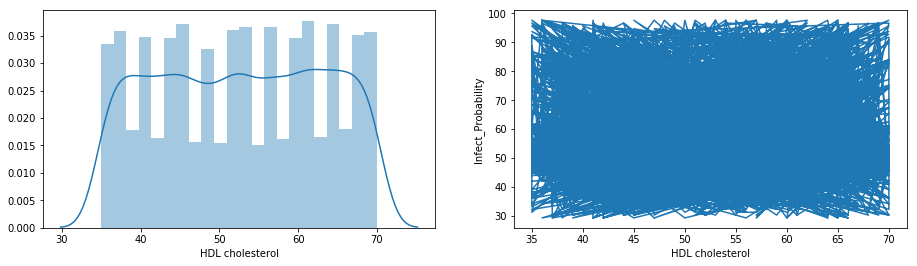

In [28]:


print("Null Values in HDL cholesterol Feature in Train: "+str(train['HDL cholesterol'].isnull().sum()))
print("Null Values in HDL cholesterol Feature in Test: "+str(test['HDL cholesterol'].isnull().sum()))
print(train['HDL cholesterol'].describe())

# Replace the Nan values with Mean or median since they both are same and there are no outliers
train['HDL cholesterol']=train['HDL cholesterol'].fillna(53.00)
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['HDL cholesterol'])
plt.subplot(1,2,2)
plt.plot(train['HDL cholesterol'],train['Infect_Prob'])
plt.xlabel("HDL cholesterol")
plt.ylabel("Infect_Probability")



Null Values in Charlson Index Feature in Train: 0
Null Values in Charlson Index Feature in Test: 0


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]), <a list of 41 Text xticklabel objects>)

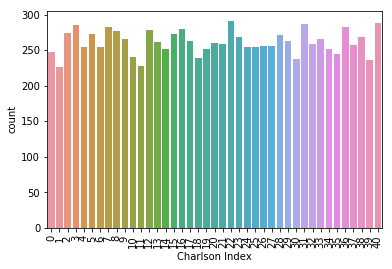

In [29]:

print("Null Values in Charlson Index Feature in Train: "+str(train['Charlson Index'].isnull().sum()))
print("Null Values in Charlson Index Feature in Test: "+str(test['Charlson Index'].isnull().sum()))
sns.countplot(train['Charlson Index'])
plt.xticks(rotation=90)

Null Values in Blood Glucose Feature in Train: 0
Null Values in Blood Glucose Feature in Test: 0


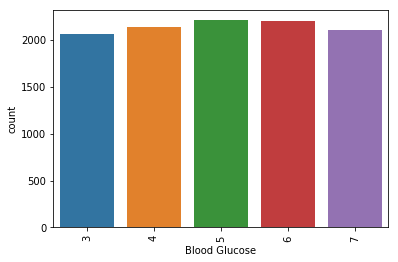

In [30]:

sns.countplot(train['Blood Glucose'])
plt.xticks(rotation=90)



print("Null Values in Blood Glucose Feature in Train: "+str(train['Blood Glucose'].isnull().sum()))
print("Null Values in Blood Glucose Feature in Test: "+str(test['Blood Glucose'].isnull().sum()))



Null Values in Insurance Feature in Train: 1090
Null Values in Insurance Feature in Test: 0
count    9.624000e+03
mean     2.644919e+06
std      1.383346e+06
min      3.000000e+05
25%      1.400000e+06
50%      2.600000e+06
75%      3.800000e+06
max      5.000000e+06
Name: Insurance, dtype: float64


Text(0,0.5,'Infect_Probability')

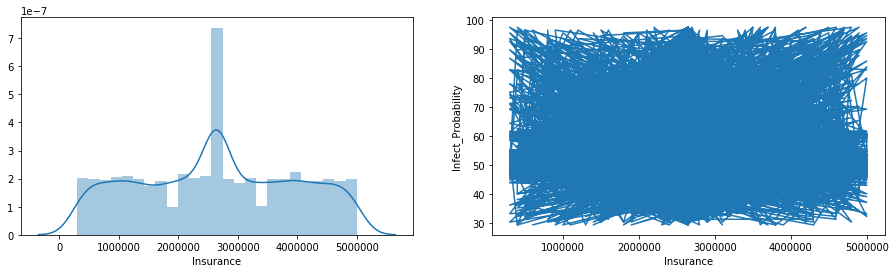

In [31]:

print("Null Values in Insurance Feature in Train: "+str(train['Insurance'].isnull().sum()))
print("Null Values in Insurance Feature in Test: "+str(test['Insurance'].isnull().sum()))
print(train['Insurance'].describe())

# Lets replace the null values with mean values i.e 2644919
train['Insurance']=train['Insurance'].fillna(2644919)
plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.distplot(train['Insurance'])
plt.subplot(1,2,2)
plt.plot(train['Insurance'],train['Infect_Prob'])
plt.xlabel("Insurance")
plt.ylabel("Infect_Probability")

Null Values in salary Feature in Train: 0
Null Values in salary Feature in Test: 0


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20]), <a list of 21 Text xticklabel objects>)

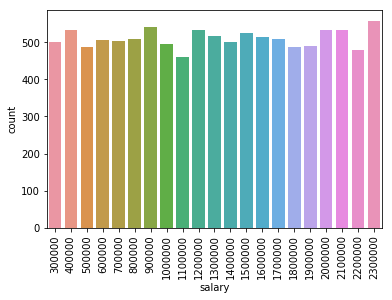

In [32]:
print("Null Values in salary Feature in Train: "+str(train['salary'].isnull().sum()))
print("Null Values in salary Feature in Test: "+str(test['salary'].isnull().sum()))

sns.countplot(train['salary'])
plt.xticks(rotation=90)

Null Values in FT/month Feature in Train: 723
Null Values in FT/month Feature in Test: 0


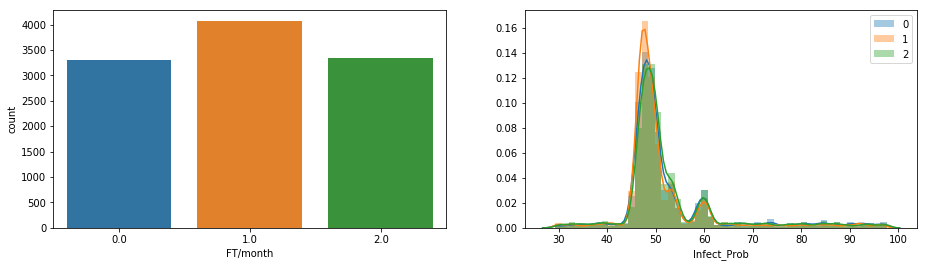

In [33]:
print("Null Values in FT/month Feature in Train: "+str(train['FT/month'].isnull().sum()))
print("Null Values in FT/month Feature in Test: "+str(test['FT/month'].isnull().sum()))

# Lets replace the null values with mode i.e 1.00
train['FT/month']=train['FT/month'].fillna(1.00)


plt.subplots_adjust(left=11,right=13)
plt.subplot(1,2,1)
sns.countplot(train['FT/month'])
plt.subplot(1,2,2)

df0=train[train['FT/month']==0.0]
df1=train[train['FT/month']==1.0]
df2=train[train['FT/month']==2.0]

sns.distplot(df0.Infect_Prob)
sns.distplot(df1.Infect_Prob)
sns.distplot(df2.Infect_Prob)
plt.legend(['0','1','2'])





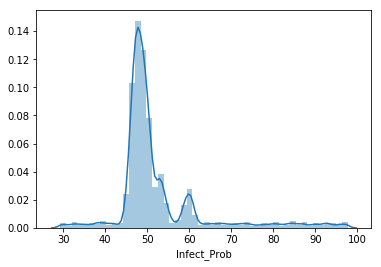

In [34]:
# Let's see the distribution of InfectProb
sns.distplot(train['Infect_Prob'])

In [35]:
train.head()

,Region,Gender,Married,Children,Occupation,Mode_transport,cases/1M,Deaths/1M,comorbidity,Age,...,HBB,d-dimer,Heart rate,HDL cholesterol,Charlson Index,Blood Glucose,Insurance,salary,FT/month,Infect_Prob
0,Bhubaneshwar,Female,YES,1.0,Farmer,Public,2,0,Hypertension,68,...,93.0,233.0,82.0,58.0,27,7,3600000.0,1300000,2.0,49.135010
1,Bhubaneshwar,Female,YES,2.0,Farmer,Walk,2,0,Diabetes,64,...,56.0,328.0,89.0,68.0,5,6,1600000.0,400000,1.0,51.147880
2,Bhubaneshwar,Female,NO,1.0,Cleaner,Public,2,0,None,19,...,137.0,213.0,77.0,43.0,40,6,3400000.0,900000,1.0,73.224000
3,Bhubaneshwar,Female,YES,1.0,Driver,Car,2,0,Coronary Heart Disease,33,...,167.0,275.0,64.0,60.0,27,7,700000.0,2300000,1.0,48.779225
4,Bhubaneshwar,Female,NO,2.0,Manufacturing,Car,2,0,Diabetes,23,...,153.0,331.0,71.0,64.0,32,7,3200000.0,1100000,1.0,87.868800


In [36]:
df=pd.concat([train,test],axis=0,sort=False)

In [37]:
df.iloc[10713:10715]

,Region,Gender,Married,Children,Occupation,Mode_transport,cases/1M,Deaths/1M,comorbidity,Age,...,HBB,d-dimer,Heart rate,HDL cholesterol,Charlson Index,Blood Glucose,Insurance,salary,FT/month,Infect_Prob
10713,Bengaluru,Male,NO,2.0,Business,Car,8,2,Diabetes,17,...,134.0,201.0,82.0,60.0,4,3,2100000.0,1400000,0.0,68.3424
0,Delhi,Female,YES,2.0,Driver,Public,4,1,Diabetes,52,...,196.0,240.0,85.0,53.0,17,3,3900000.0,1300000,1.0,NaN


In [38]:
one_hot=pd.get_dummies(df[['Region','Gender','Married','Occupation','Mode_transport','comorbidity']])
one_hot.drop(['Region_Bengaluru','Gender_Male','Married_NO','Occupation_Business','Mode_transport_Car','comorbidity_Diabetes'],axis=1,inplace=True)
df.drop(['Region','Gender','Married','Occupation','Mode_transport','comorbidity'],axis=1,inplace=True)
df_new=pd.concat([df,one_hot],axis=1)


In [39]:
train=df_new.iloc[:10714]
test=df_new.iloc[10714:]
test.drop(['Infect_Prob'],axis=1,inplace=True)
df_new.iloc[10713:10715]

C:\Users\user\Anaconda3\lib\site-packages\pandas\core\frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


,Children,cases/1M,Deaths/1M,Age,Coma score,Pulmonary score,cardiological pressure,Diuresis,Platelets,HBB,...,Occupation_Farmer,Occupation_Legal,Occupation_Manufacturing,Occupation_Researcher,Occupation_Sales,Mode_transport_Public,Mode_transport_Walk,comorbidity_Coronary Heart Disease,comorbidity_Hypertension,comorbidity_None
10713,2.0,8,2,17,7,<400,Normal,181.0,65.0,134.0,...,0,0,0,0,0,0,0,0,0,0
0,2.0,4,1,52,3,<200,Stage-01,388.0,153.0,196.0,...,0,0,0,0,0,1,0,0,0,0


In [40]:
train.replace({'<100':0,'<200':1,'<300':2,'<400':3},inplace=True)
test.replace({'<100':0,'<200':1,'<300':2,'<400':3},inplace=True)

train.replace({'Normal':0,'Stage-01':1,'Stage-02':2,'Elevated':3},inplace=True)
test.replace({'Normal':0,'Stage-01':1,'Stage-02':2,'Elevated':3},inplace=True)

C:\Users\user\Anaconda3\lib\site-packages\pandas\core\frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


In [41]:
train.shape

(10714, 43)

In [42]:
test.shape

(14498, 42)

In [59]:
X=train.drop(['Infect_Prob'],axis=1)
y=train[['Infect_Prob']]

In [60]:
X.head()

,Children,cases/1M,Deaths/1M,Age,Coma score,Pulmonary score,cardiological pressure,Diuresis,Platelets,HBB,...,Occupation_Farmer,Occupation_Legal,Occupation_Manufacturing,Occupation_Researcher,Occupation_Sales,Mode_transport_Public,Mode_transport_Walk,comorbidity_Coronary Heart Disease,comorbidity_Hypertension,comorbidity_None
0,1.0,2,0,68,8,3,0,441.0,154.0,93.0,...,1,0,0,0,0,1,0,0,1,0
1,2.0,2,0,64,15,0,2,276.0,121.0,56.0,...,1,0,0,0,0,0,1,0,0,0
2,1.0,2,0,19,13,2,3,416.0,124.0,137.0,...,0,0,0,0,0,1,0,0,0,1
3,1.0,2,0,33,9,1,1,410.0,98.0,167.0,...,0,0,0,0,0,0,0,1,0,0
4,2.0,2,0,23,7,3,0,390.0,21.0,153.0,...,0,0,1,0,0,0,0,0,0,0


In [45]:
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import normalize
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV


In [75]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.1,random_state=212)
print("X_train Shape: "+str(X_train.shape))
print("y_train_shape: "+str(y_train.shape))
print("X_test_shape: "+str(X_test.shape))
print("y_test_shape: "+str(y_test.shape))




X_train Shape: (9642, 42)
y_train_shape: (9642, 1)
X_test_shape: (1072, 42)
y_test_shape: (1072, 1)


In [79]:
# Since we are using Random Forest regressor So there is no need to scale the Data
rf=RandomForestRegressor(random_state=121,n_estimators=200)
params_grid={'max_depth':[1,2,3,4],'min_samples_split':[2,3,4,5,6,7],'min_samples_leaf':[2,3,4,5,6,7],'max_features':[2,3,4,5,6,7],'max_leaf_nodes':[2,3,4,5]}
rf_cv=GridSearchCV(rf,params_grid,cv=20)
rf_cv.fit(X_train,y_train)

C:\Users\user\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\Users\user\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\Users\user\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\Users\user\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was pa

GridSearchCV(cv=20, error_score='raise-deprecating',
             estimator=RandomForestRegressor(bootstrap=True, criterion='mse',
                                             max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=200, n_jobs=None,
                                             oob_score=False, random_state=121,
                                             verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'max_depth': [1, 2, 3, 4],
       

In [80]:
rf_cv.best_params_

{'max_depth': 4,
 'max_features': 7,
 'max_leaf_nodes': 5,
 'min_samples_leaf': 7,
 'min_samples_split': 2}

In [88]:
rf_cv.cv_results_.keys()

dict_keys(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time', 'param_max_depth', 'param_max_features', 'param_max_leaf_nodes', 'param_min_samples_leaf', 'param_min_samples_split', 'params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'split5_test_score', 'split6_test_score', 'split7_test_score', 'split8_test_score', 'split9_test_score', 'split10_test_score', 'split11_test_score', 'split12_test_score', 'split13_test_score', 'split14_test_score', 'split15_test_score', 'split16_test_score', 'split17_test_score', 'split18_test_score', 'split19_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score'])

In [89]:
mean_score=rf_cv.cv_results_['mean_test_score']

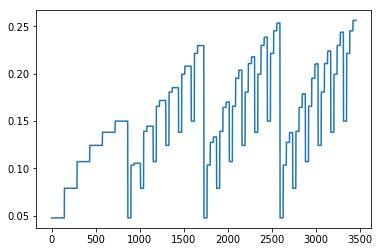

In [90]:
plt.plot(np.arange(len(mean_score)),mean_score)

In [94]:
rf_cv.cv_results_

{'mean_fit_time': array([0.42342405, 0.40756375, 0.42332094, ..., 1.20104053, 1.20649617,
        1.20781466]),
 'std_fit_time': array([0.01727783, 0.03363909, 0.04148311, ..., 0.04970804, 0.04025625,
        0.04055325]),
 'mean_score_time': array([0.0221056 , 0.0219864 , 0.02272838, ..., 0.02378948, 0.02394621,
        0.02448715]),
 'std_score_time': array([0.00335899, 0.00209721, 0.00371279, ..., 0.00295858, 0.00213329,
        0.00241766]),
 'param_max_depth': masked_array(data=[1, 1, 1, ..., 4, 4, 4],
              mask=[False, False, False, ..., False, False, False],
        fill_value='?',
             dtype=object),
 'param_max_features': masked_array(data=[2, 2, 2, ..., 7, 7, 7],
              mask=[False, False, False, ..., False, False, False],
        fill_value='?',
             dtype=object),
 'param_max_leaf_nodes': masked_array(data=[2, 2, 2, ..., 5, 5, 5],
              mask=[False, False, False, ..., False, False, False],
        fill_value='?',
             dtype=ob

In [108]:
rf=RandomForestRegressor(n_estimators=200,max_depth=4,max_features=7,max_leaf_nodes=5,min_samples_leaf=7,min_samples_split=2)
rf.fit(X_train,y_train)
y_pred_train=rf.predict(X_train)
y_pred_test=rf.predict(X_test)

mse_train=mean_squared_error(y_train,y_pred_train)
mse_test=mean_squared_error(y_test,y_pred_test)

print('MSE:Train :'+str(mse_train))
print('MSE:Test :'+str(mse_test))

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


MSE:Train :85.04137194892239
MSE:Test :75.38846919970709


In [110]:
Infect_prob_test=rf.predict(test)

In [117]:
test=pd.read_excel("Test_dataset.xlsx")
Test=test[['people_ID']]
Test['Infect_Prob']=Infect_prob_test

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [120]:
Test.head()

,people_ID,Infect_Prob
0,5942,52.672818
1,18664,52.722694
2,5603,52.491545
3,5649,52.561845
4,5099,52.662746


In [122]:
Test.to_csv("Test.csv",index=False)